In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
import os
os.chdir('/content/drive/MyDrive/PhD/extention/')

In [9]:
%%capture
!pip install category_encoders

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import plotly.express as px
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)

import torch

from gan.dgan import DGAN
from gan.config import DGANConfig, OutputType

# Get data and preprocess

In [2]:
# Custom dataset class for loading data from CSV
def EnergyDataset(filename):
    COLUMNS = ['z1_AC1(kW)', 'z1_AC2(kW)', 'z1_AC3(kW)', 'z1_AC4(kW)', 'z1_Light(kW)', 'z1_Plug(kW)', 'z2_AC1(kW)', 'z2_Light(kW)', 'z2_Plug(kW)',
           'z3_Light(kW)', 'z3_Plug(kW)','z4_AC1(kW)', 'z4_Light(kW)', 'z4_Plug(kW)', 'z5_AC1(kW)', 'z5_Light(kW)', 'z5_Plug(kW)']
    df = pd.read_csv(filename)
    df['Date'] = pd.to_datetime(df['Date'], errors= 'coerce')
    df[COLUMNS] = df[COLUMNS].replace('', np.nan)
    df = df.dropna(subset=COLUMNS, how = 'all')

    df.sort_values('Date', inplace = True)
    df.rename(columns={"Date": "datetime"}, inplace=True)
    # df['AC'] = df[[col for col in COLUMNS if 'AC' in col]].sum(axis=1)
    # df['Plug'] = df[[col for col in COLUMNS if 'Plug' in col]].sum(axis=1)
    # df['Light'] = df[[col for col in COLUMNS if 'Light' in col]].sum(axis=1)
    df['datetime'] = pd.to_datetime(df['datetime'])
    
    start_date = pd.Timestamp('2018-10-11 16:11')
    end_date = pd.Timestamp('2018-11-21 11:52')
    df = df[(df['datetime'] < start_date) | (df['datetime'] > end_date)]
    df.set_index(pd.date_range(end=pd.to_datetime('2018-12-31 23:59:00'), freq='1T', periods=len(df)),
                 inplace = True)
    df.reset_index(inplace=True)
    df = df.drop('datetime', axis = 1).rename(columns={'index': 'datetime'})
    df = df[['datetime','z1_AC1(kW)', 'z1_AC2(kW)', 'z1_AC3(kW)', 'z1_AC4(kW)', 'z1_Light(kW)', 'z1_Plug(kW)', 'z2_AC1(kW)', 'z2_Light(kW)', 'z2_Plug(kW)', 'z3_Light(kW)', 'z3_Plug(kW)','z4_AC1(kW)', 'z4_Light(kW)', 'z4_Plug(kW)', 'z5_AC1(kW)', 'z5_Light(kW)', 'z5_Plug(kW)']]

    df = df.dropna(subset = ['z1_AC1(kW)', 'z1_AC2(kW)', 'z1_AC3(kW)', 'z1_AC4(kW)', 'z1_Light(kW)', 'z1_Plug(kW)', 'z2_AC1(kW)', 'z2_Light(kW)', 'z2_Plug(kW)', 'z3_Light(kW)', 'z3_Plug(kW)','z4_AC1(kW)', 'z4_Light(kW)', 'z4_Plug(kW)', 'z5_AC1(kW)', 'z5_Light(kW)', 'z5_Plug(kW)'] ,how='all')
    return df

In [3]:
# sensor_df = pd.concat([EnergyDataset('2018Floor3.csv'),EnergyDataset('2019Floor3.csv')])
sensor_df = EnergyDataset('2018Floor3.csv')
sensor_df

,datetime,z1_AC1(kW),z1_AC2(kW),z1_AC3(kW),z1_AC4(kW),z1_Light(kW),z1_Plug(kW),z2_AC1(kW),z2_Light(kW),z2_Plug(kW),z3_Light(kW),z3_Plug(kW),z4_AC1(kW),z4_Light(kW),z4_Plug(kW),z5_AC1(kW),z5_Light(kW),z5_Plug(kW)
0,2018-08-11 01:51:00,0.0,0.0,0.0,0.07,0.0,0.03,0.0,0.0,0.03,0.01,0.26,0.0,0.0,0.02,0.0,0.0,0.02
1,2018-08-11 01:52:00,0.0,0.0,0.0,0.07,0.0,0.03,0.0,0.0,0.03,0.02,0.37,0.0,0.0,0.02,0.0,0.0,0.02
2,2018-08-11 01:53:00,0.0,0.0,0.0,0.07,0.0,0.03,0.0,0.0,0.03,0.01,0.32,0.0,0.0,0.02,0.0,0.0,0.02
3,2018-08-11 01:54:00,0.0,0.0,0.0,0.07,0.0,0.03,0.0,0.0,0.03,0.01,0.26,0.0,0.0,0.02,0.0,0.0,0.02
4,2018-08-11 01:55:00,0.0,0.0,0.0,0.07,0.0,0.03,0.0,0.0,0.03,0.02,0.37,0.0,0.0,0.02,0.0,0.0,0.02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205804,2018-12-31 23:55:00,0.0,0.0,0.0,0.07,0.0,0.03,0.0,0.0,0.02,0.01,0.37,0.0,0.0,0.01,0.0,0.0,0.02
205805,2018-12-31 23:56:00,0.0,0.0,0.0,0.07,0.0,0.03,0.0,0.0,0.02,0.02,0.37,0.0,0.0,0.01,0.0,0.0,0.02
205806,2018-12-31 23:57:00,0.0,0.0,0.0,0.07,0.0,0.03,0.0,0.0,0.02,0.01,0.37,0.0,0.0,0.01,0.0,0.0,0.02
205807,2018-12-31 23:58:00,0.0,0.0,0.0,0.06,0.0,0.03,0.0,0.0,0.02,0.01,0.37,0.0,0.0,0.01,0.0,0.0,0.02


# visualize features 

In [4]:
# Use 4 temperature columns for this example
COLUMNS = ['z1_AC1(kW)', 'z1_AC2(kW)', 'z1_AC3(kW)', 'z1_AC4(kW)', 'z1_Light(kW)', 'z1_Plug(kW)', 'z2_AC1(kW)', 'z2_Light(kW)', 'z2_Plug(kW)', 'z3_Light(kW)', 'z3_Plug(kW)','z4_AC1(kW)', 'z4_Light(kW)', 'z4_Plug(kW)', 'z5_AC1(kW)', 'z5_Light(kW)', 'z5_Plug(kW)']
train_df = sensor_df
sensor_df = sensor_df.set_index('datetime')

C:\Users\User\anaconda3\envs\fed\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



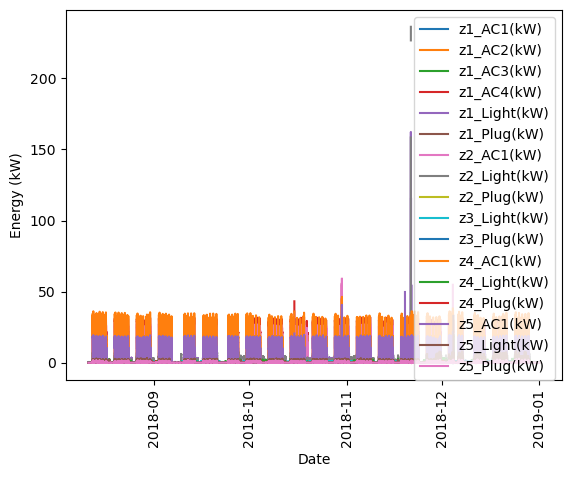

In [5]:
# Plot the 4 columns over the 4+ months of data
for c in COLUMNS:
    plt.plot(train_df["datetime"], train_df[c], label=c)
plt.xticks(rotation=90)
plt.legend()
plt.ylabel("Energy (kW)")
plt.xlabel("Date")
plt.show()

# create sligin windows of a full day of 1440 seconds

In [6]:
# DGAN needs many example time series to train. Split into 1-day slices to
# create multiple examples.
windows_size = 1440
features = train_df.drop(columns="datetime").to_numpy()
# Obsevations every 1 minutes, so 1440 * 1 minutes = 1 day
n = features.shape[0] // windows_size
features = features[:(n*windows_size),:].reshape(-1, windows_size, features.shape[1])
# Shape is now (# examples, # time points, # features)
print(features.shape)

(142, 1440, 17)


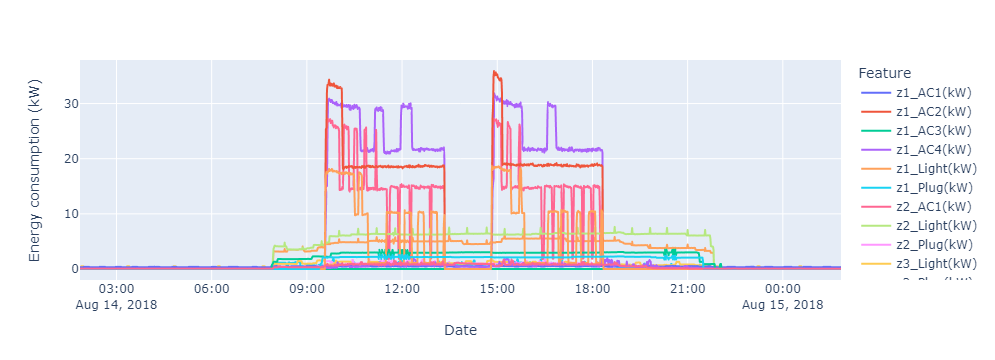

In [11]:
fig = px.line(sensor_df.iloc[windows_size*3:windows_size*4])
fig.update_layout(
    # title="Line Chart Title",
    xaxis_title="Date",
    yaxis_title="Energy consumption (kW)",
    legend_title="Feature",
)
fig.show()

# GAN

In [12]:
# Recommended to train with a GPU
torch.cuda.is_available()

True

## Initialize model

In [7]:
%%capture

# Train DGAN model
model = DGAN(DGANConfig(
    max_sequence_len=features.shape[1],
    sample_len=windows_size,
    batch_size=min(1000, features.shape[0]),
    apply_feature_scaling=True,
    apply_example_scaling=False,
    use_attribute_discriminator=False,
    generator_learning_rate= 0.0001,
    discriminator_learning_rate= 0.0001,
    epochs=10000,
))

## Train and save gan models

In [32]:
model.train_numpy(
    features,
    feature_types=[OutputType.CONTINUOUS] * features.shape[2],
)
model.save("saved_models/model_gan_2018_")

2024-03-18 21:24:37,376 : MainThread : WARNING : There are 9 examples that have too many nan values in numeric features, accounting for 6.338028169014084% of all examples. These invalid examples will be omitted from training.
2024-03-18 21:24:38,522 : MainThread : INFO : epoch: 0
2024-03-18 21:25:13,380 : MainThread : INFO : epoch: 1
2024-03-18 21:25:41,584 : MainThread : INFO : epoch: 2
2024-03-18 21:26:09,237 : MainThread : INFO : epoch: 3
2024-03-18 21:26:37,591 : MainThread : INFO : epoch: 4
2024-03-18 21:27:04,842 : MainThread : INFO : epoch: 5
2024-03-18 21:27:31,885 : MainThread : INFO : epoch: 6
2024-03-18 21:27:58,690 : MainThread : INFO : epoch: 7
2024-03-18 21:28:25,550 : MainThread : INFO : epoch: 8
2024-03-18 21:28:51,592 : MainThread : INFO : epoch: 9
2024-03-18 21:29:18,180 : MainThread : INFO : epoch: 10
2024-03-18 21:29:44,547 : MainThread : INFO : epoch: 11
2024-03-18 21:30:10,896 : MainThread : INFO : epoch: 12
2024-03-18 21:30:38,564 : MainThread : INFO : epoch: 13


## Load model that is already trained

In [8]:
# to load model instead of always training do this
model1 = DGAN(DGANConfig(
    max_sequence_len=features.shape[1],
    sample_len=windows_size,
    batch_size=min(1000, features.shape[0]),
    apply_feature_scaling=True,
    apply_example_scaling=False,
    use_attribute_discriminator=False,
    generator_learning_rate= 0.0001,
    discriminator_learning_rate= 0.0001,
    epochs=10000,
))
model1 = model1.load("saved_models/model_gan_2018")

## generate 100 clients in 2018 every 1 second 

In [38]:
feature_noise = torch.randn(features.shape[0], windows_size, 1)
client_size = 100
for i in range(0, client_size):
    rate = 0.0001
    _, synthetic_features = model.generate_numpy(features.shape[0],feature_noise = feature_noise * rate)
    synthetic_df = pd.DataFrame(synthetic_features.reshape(-1, synthetic_features.shape[2]), columns=train_df.columns[1:])
    # date_range = pd.DataFrame(pd.date_range(start=pd.to_datetime('2018-01-01 06:00:00'), freq='1T', periods=len(synthetic_df)), columns=  ['Date'])
    
    # viz = pd.concat([date_range, synthetic_df], axis=1)
    viz = synthetic_df.set_index(sensor_df[len(sensor_df) - len(synthetic_df):].index).reset_index(names = 'Date')
    viz.to_csv(f'gen_data18/2018Floor{i}.csv', index=False)
    rate = rate + 0.0001

# Visualise newly generated data

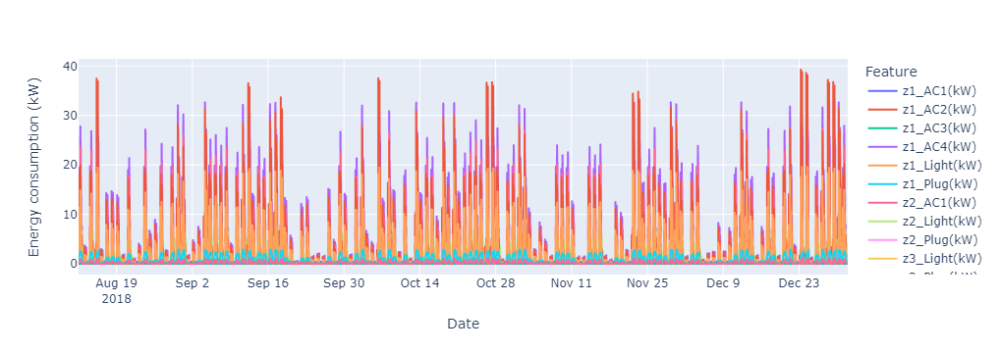

In [39]:
viz.set_index('Date', inplace = True)
fig = px.line(viz.resample('10T').mean())
fig.update_layout(
    # title="Line Chart Title",
    xaxis_title="Date",
    yaxis_title="Energy consumption (kW)",
    legend_title="Feature",
)
fig.show()

In [ ]:
fig = px.line(sensor_df.resample('10T').mean())
fig.update_layout(
    # title="Line Chart Title",
    xaxis_title="Date",
    yaxis_title="Energy consumption (kW)",
    legend_title="Feature",
)
fig.show()

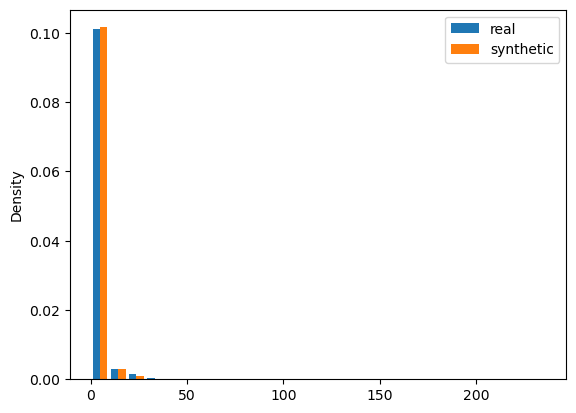

In [32]:
# Compare distribution of T_out values
plt.hist([features[:,:,:].flatten(), synthetic_features[:,:,:].flatten()],
         label=["real", "synthetic"],
         bins=25,
         density=True)
plt.legend()
# plt.xlabel("Temperature (Celsius)")
plt.ylabel("Density")
plt.show()

# Temperature distribution for T_out is similar

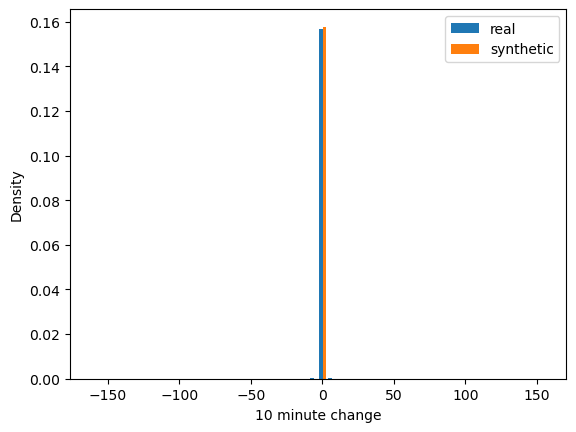

In [33]:
# Compare distribution of 1-step (10 minute) diffs for T_out
real_diffs = np.diff(features, axis=1)
synthetic_diffs = np.diff(synthetic_features, axis=1)

plt.hist([real_diffs[:,:,:].flatten(), synthetic_diffs[:,:,:].flatten()],
         label=["real", "synthetic"],
         bins=50,
         density=True)
plt.legend()
plt.xlabel("10 minute change")
plt.ylabel("Density")
plt.show()

# 1-step diffs for synthetic data have higher variance, this aligns with the
# increased noise visible in the plots